In [1]:
import numpy as np
from math import pi

import os
import librosa
import IPython.display as ipd

from QuiKo_Backend import *
from Quiko_Analysis import *
from Quiko_Preprocessing import *
from Quiko_Feature_extraction import *

from Quiko_Beat_Constr import *

configrc.store_credentials:WARNING:2021-08-18 19:00:59,498: Credentials already present. Set overwrite=True to overwrite.


Testing Version...
Loading IBM Account...
Loading analysis testing version...
Loading IBM Account...


In [2]:
## Step 1. Generate the Quantum State Database of all the audio samples
## Future: use the filter bank to generate 

In [3]:
bundle, qstates, tracks = Init_Database( 'dir' ) # Think about have shots be included as a parameter here

/Users/scottoshiro/Desktop/Programming_Environments/QuiKo_Workspace/Quiko_Feature_extraction.py:106: RuntimeWarning: invalid value encountered in double_scalars
  weighted_avg = np.round( np.sum( weighted_avg ) / np.sum(weights), 3 )


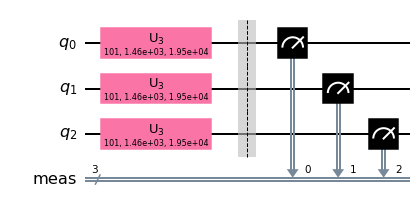

In [4]:
qc = bundle[7]
qc.draw(output='mpl')

In [5]:
qstates

[{'100': 1,
  '010': 3,
  '000': 1020,
  '001': 0,
  '011': 0,
  '101': 0,
  '110': 0,
  '111': 0},
 {'001': 127,
  '110': 146,
  '100': 102,
  '111': 162,
  '011': 130,
  '010': 111,
  '000': 107,
  '101': 139},
 {'111': 1024,
  '000': 0,
  '001': 0,
  '010': 0,
  '011': 0,
  '100': 0,
  '101': 0,
  '110': 0},
 {'000': 39,
  '010': 69,
  '001': 73,
  '100': 62,
  '110': 150,
  '101': 145,
  '011': 155,
  '111': 331},
 {'111': 1,
  '011': 2,
  '110': 1,
  '100': 58,
  '001': 50,
  '000': 854,
  '010': 53,
  '101': 5},
 {'100': 12,
  '001': 15,
  '011': 1,
  '010': 11,
  '000': 985,
  '101': 0,
  '110': 0,
  '111': 0},
 {'000': 2,
  '010': 21,
  '111': 623,
  '011': 117,
  '001': 15,
  '100': 21,
  '110': 128,
  '101': 97},
 {'101': 1,
  '110': 1,
  '001': 25,
  '100': 25,
  '011': 1,
  '010': 33,
  '000': 938,
  '111': 0},
 {'101': 32,
  '100': 147,
  '110': 45,
  '001': 115,
  '111': 10,
  '011': 35,
  '010': 119,
  '000': 521},
 {'010': 1,
  '001': 1,
  '110': 9,
  '100': 1,
  '101':

In [6]:
## Step 2. Generate the feature extraction of the input audio track...
## Before we do the random cases for the results and performance of the system test to see if the 
## output makes any sense...But assume for now the segmentation process works

In [7]:
y, fs = librosa.load('<Input audio file PATH>')

In [8]:
ipd.Audio(y, rate=fs)

In [9]:
meas_info = segmentation( fs, y )
barline, bar_samp = meas_info.measure_segment()
## Let's iterate through the measures
list_meas = meas_info.measure_array( bar_samp )

In [10]:
## This is for the webaudio API part to use for the construction
tempo_sec = meas_info.tempo_est()
meas_sec  = barline

eightnote_time = meas_sec / 8
print( 'eightnoteTime: ', round( eightnote_time,3 ) )
print( 'tempo: ', round( tempo_sec ) )
print( 'measure_time', round(meas_sec,3) )

eightnoteTime:  0.267
tempo:  112
measure_time 2.136


In [11]:
import scipy.io.wavfile

meas_num = 16 # User input...for later, This can also be used to add to database...
input_meas = list_meas[meas_num]
scipy.io.wavfile.write("Stay_w_Me_input16.wav", fs, input_meas)
ipd.Audio( input_meas, rate=fs )

In [12]:
## Set up filter bank, Don't think they need to be in a class...
input_meas_low   = butter_lowpass_filter( input_meas, 500, fs )
input_meas_mid   = butter_bandpass_filter( input_meas, 500, 5000, fs )
input_meas_high  = butter_highpass_filter( input_meas, 5000, fs )

In [13]:
## Let's Check the filtered Audio...

In [14]:
hpss = p_proc( input_meas_low, input_meas_mid, input_meas_high, fs )
feature_matrix = []
for band in hpss:
    feature_matrix.append( preproc( hpss[band][1], hpss[band][0], 8, fs ) )

In [15]:
feature_matrix

[{'000': {'harm_est': 0.38, 'spec_cent': 1.35, 'perc_est': 10.196},
  '001': {'harm_est': 0.403, 'spec_cent': 1.354, 'perc_est': 6.517},
  '010': {'harm_est': 0.396, 'spec_cent': 1.162, 'perc_est': 12.925},
  '011': {'harm_est': 0.343, 'spec_cent': 1.167, 'perc_est': 6.986},
  '100': {'harm_est': 0.324, 'spec_cent': 1.149, 'perc_est': 3.103},
  '101': {'harm_est': 0.306, 'spec_cent': 1.114, 'perc_est': 8.902},
  '110': {'harm_est': 0.452, 'spec_cent': 1.274, 'perc_est': 17.196},
  '111': {'harm_est': 0.503, 'spec_cent': 1.34, 'perc_est': 5.712}},
 {'000': {'harm_est': 0.126, 'spec_cent': 0.377, 'perc_est': 12.176},
  '001': {'harm_est': 0.15, 'spec_cent': 0.401, 'perc_est': 12.995},
  '010': {'harm_est': 0.144, 'spec_cent': 0.414, 'perc_est': 12.807},
  '011': {'harm_est': 0.147, 'spec_cent': 0.399, 'perc_est': 1.431},
  '100': {'harm_est': 0.104, 'spec_cent': 0.369, 'perc_est': 7.248},
  '101': {'harm_est': 0.08, 'spec_cent': 0.292, 'perc_est': 3.718},
  '110': {'harm_est': 0.077, 'sp

In [16]:
## Now I just have to becareful feeding it into the encdoing method...

In [17]:
features = feature_dict( feature_matrix )
features

[[[0.38, 1.35, 10.196],
  [0.403, 1.354, 6.517],
  [0.396, 1.162, 12.925],
  [0.343, 1.167, 6.986],
  [0.324, 1.149, 3.103],
  [0.306, 1.114, 8.902],
  [0.452, 1.274, 17.196],
  [0.503, 1.34, 5.712]],
 [[0.126, 0.377, 12.176],
  [0.15, 0.401, 12.995],
  [0.144, 0.414, 12.807],
  [0.147, 0.399, 1.431],
  [0.104, 0.369, 7.248],
  [0.08, 0.292, 3.718],
  [0.077, 0.302, 23.803],
  [0.094, 0.339, 1.305]],
 [[0.017, 0.056, 13.949],
  [0.015, 0.051, 17.351],
  [0.014, 0.052, 28.499],
  [0.012, 0.053, 1.259],
  [0.016, 0.055, 8.573],
  [0.014, 0.051, 32.745],
  [0.017, 0.055, 31.668],
  [0.017, 0.056, 2.962]]]

In [18]:
pkbse = 1
num_bands = 3
Encoding_method = 1

spine_qubits = 3; cbits = 6
meas_map = [[0,1,2,3,4,5],[0,1,2,3,4,5]]
parameters = Encoding_matrix( features, 8, 3, 3)
pkbse_matrix = parameters.pkbse_encoding_matrix()
#static_matrix = parameters.static_encoding_matrix()

qcirc = QuikoCircuit( num_bands, spine_qubits, cbits, pkbse_matrix, Encoding_method )
qc = qcirc.Quantum_Circuit( Encoding_method,meas_map=meas_map )

In [19]:
pkbse_matrix

[[[[1.522, -1.179, -0.783, -0.38], [1.585, -1.082, -0.63, -0.324]],
  [[5.033, -3.866, -2.704, -1.35], [4.877, -3.537, -2.263, -1.149]],
  [[36.624, -29.638, -16.713, -10.196], [34.913, -29.201, -12.005, -3.103]]],
 [[[0.567, -0.42, -0.276, -0.126], [0.355, -0.261, -0.184, -0.104]],
  [[1.591, -1.192, -0.778, -0.377], [1.302, -0.963, -0.661, -0.369]],
  [[39.409, -37.978, -25.171, -12.176], [36.074, -34.769, -10.966, -7.248]]],
 [[[0.058, -0.046, -0.032, -0.017], [0.064, -0.047, -0.03, -0.016]],
  [[0.212, -0.159, -0.107, -0.056], [0.217, -0.161, -0.106, -0.055]],
  [[61.058, -59.799, -31.3, -13.949], [75.948, -72.986, -41.318, -8.573]]]]

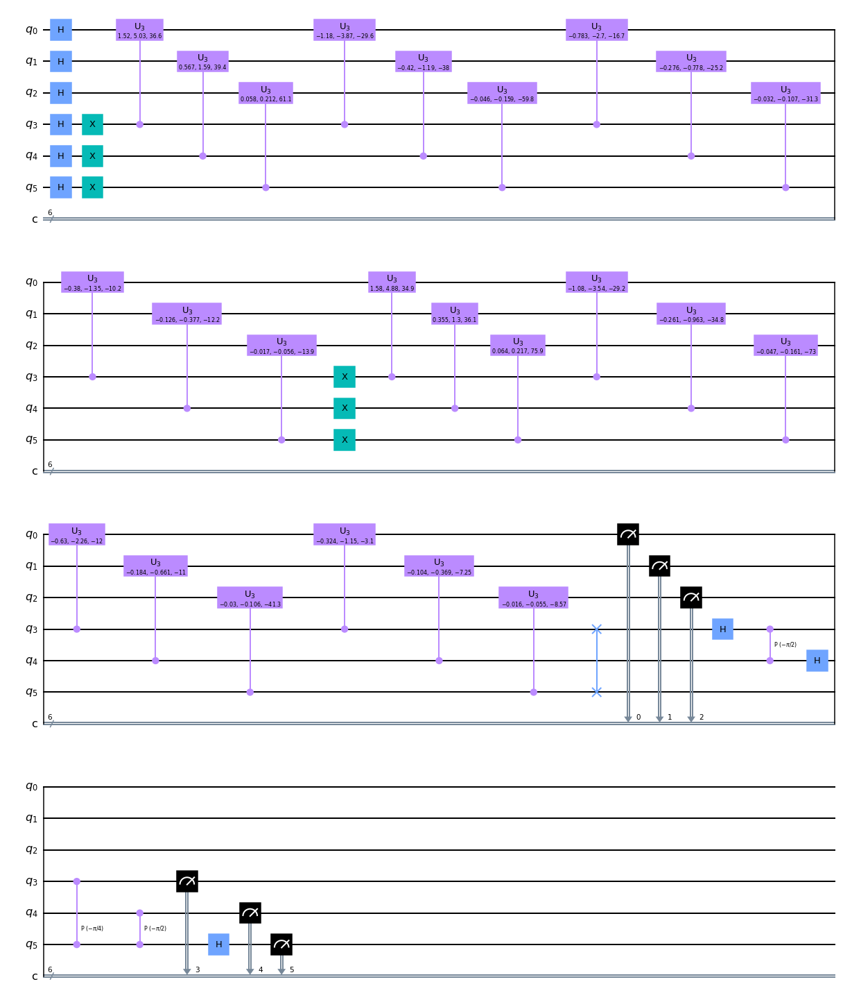

In [20]:
qc.draw(output='mpl')

In [21]:
results = execute_quantumcircuit( qc, dev='ibmq_montreal' )

Job Status: job has successfully run


In [22]:
import qiskit
qiskit.__qiskit_version__

/Users/scottoshiro/opt/anaconda3/lib/python3.8/site-packages/qiskit/aqua/__init__.py:86: DeprecationWarning: The package qiskit.aqua is deprecated. It was moved/refactored to qiskit-terra For more information see <https://github.com/Qiskit/qiskit-aqua/blob/main/README.md#migration-guide>
  warn_package('aqua', 'qiskit-terra')


{'qiskit-terra': '0.18.1', 'qiskit-aer': '0.8.2', 'qiskit-ignis': '0.6.0', 'qiskit-ibmq-provider': '0.16.0', 'qiskit-aqua': '0.9.4', 'qiskit': '0.29.0', 'qiskit-nature': None, 'qiskit-finance': None, 'qiskit-optimization': None, 'qiskit-machine-learning': None}

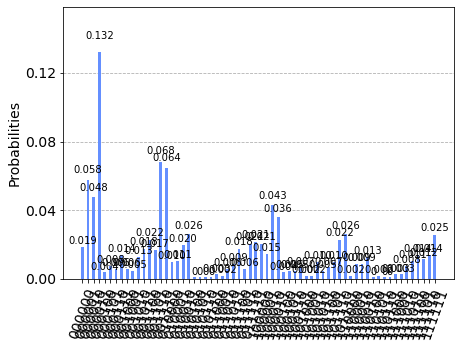

In [23]:
plot_histogram(results)

In [24]:
input_timbre = timbre_per_beat( results, 3 ) ## This is the function to extract the features per beat...
input_timbre

[{'000': 19,
  '010': 10,
  '011': 3,
  '100': 21,
  '101': 2,
  '110': 2,
  '111': 3,
  '001': 6},
 {'000': 59,
  '010': 11,
  '011': 2,
  '100': 15,
  '101': 2,
  '110': 9,
  '111': 3,
  '001': 5},
 {'010': 20,
  '011': 6,
  '000': 49,
  '100': 44,
  '101': 10,
  '110': 9,
  '111': 8,
  '001': 13},
 {'010': 27,
  '011': 9,
  '100': 37,
  '101': 5,
  '000': 135,
  '110': 13,
  '111': 11,
  '001': 18},
 {'010': 1,
  '011': 18,
  '100': 4,
  '101': 7,
  '110': 1,
  '111': 14,
  '000': 4,
  '001': 23},
 {'010': 1,
  '011': 6,
  '100': 5,
  '101': 10,
  '110': 2,
  '111': 12,
  '000': 8,
  '001': 17},
 {'010': 1,
  '011': 21,
  '100': 5,
  '101': 23,
  '110': 1,
  '111': 14,
  '000': 6,
  '001': 70},
 {'010': 1,
  '011': 22,
  '100': 7,
  '101': 27,
  '110': 1,
  '111': 26,
  '000': 14,
  '001': 66}]

In [25]:
fidelity_array = np.linspace(0, len(qstates), num=len(qstates))
gen_beat = {}
for subdiv, timbre_state in enumerate( input_timbre ):
    for track_id, state in enumerate( qstates ):
        fidelity  = fidelity_measure( 3, timbre_state, state )
        closeness = fidelity.fidelity_meas()
        fidelity_array[track_id] = round( closeness,5 )
    gen_beat['Beat {}'.format(subdiv)] = np.flip(np.argsort(fidelity_array)) #np.argsort(fidelity_array)
    #gen_beat['Beat {}'.format(subdiv)] = np.argsort(fidelity_array) 

In [33]:
## The Beat Matrix
layers = 5;
start_layer = 55; end_layer = 60
beat = {}
for subdiv in range( 2**spine_qubits ):
    samples = []
    for l, i in enumerate( gen_beat['Beat {}'.format(subdiv)] ):
        if (l > start_layer) & (l <= end_layer):
            samples.append( tracks[i] )
    beat['Beat {}'.format(subdiv)] = samples
beat

{'Beat 0': ['samp2.wav',
  'Conga_6.wav',
  'Bld_H2.wav',
  'Acu_Snr.wav',
  'samp5.wav'],
 'Beat 1': ['samp2.wav',
  'Conga_1.wav',
  'samp5.wav',
  'Conga_6.wav',
  'samp8.wav'],
 'Beat 2': ['Bnt_Snr.wav',
  'Acu_Snr.wav',
  'samp5.wav',
  'samp7.wav',
  'samp8.wav'],
 'Beat 3': ['Conga_8.wav',
  'samp2.wav',
  'samp7.wav',
  'samp11.wav',
  'samp3.wav'],
 'Beat 4': ['samp8.wav',
  'Cev_H2.wav',
  'Conga_5.wav',
  'Conga_7.wav',
  'samp19.wav'],
 'Beat 5': ['Conga_3.wav',
  'Conga_5.wav',
  'Cev_H2.wav',
  'Conga_7.wav',
  'samp19.wav'],
 'Beat 6': ['samp8.wav',
  'Conga_5.wav',
  'Cev_H2.wav',
  'Conga_7.wav',
  'Crs_Tmb.wav'],
 'Beat 7': ['samp8.wav',
  'Conga_5.wav',
  'Cev_H2.wav',
  'Conga_7.wav',
  'samp19.wav']}

In [27]:
#bt = Beat_Construction( beat )
#bt.send_to_chuck()

In [28]:
#bt.send_to_chuck( start_constr=True )

In [34]:
import json
with open('LLMas_Out_Lend_60_2.json', 'w') as outfile:
    json.dump(beat, outfile)